In [1]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt

import igraph as ig
import math
import numpy as np

import datetime
import dateutil.parser
import pytz

In [2]:
df = pd.read_csv("./datasets/data.csv")

<Axes: xlabel='id_questao'>

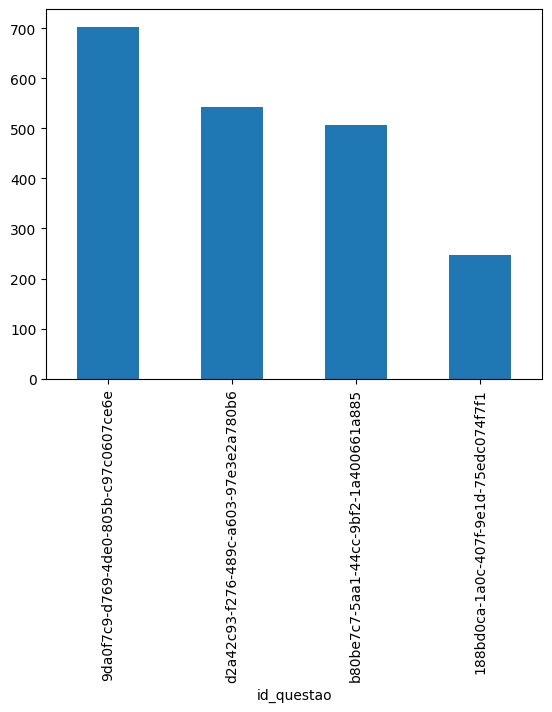

In [3]:
df["id_questao"].value_counts().plot(kind="bar")

In [4]:
grouped = df.groupby('id_aluno').agg({
    'id_questao':list, 'acerto_resposta':list, 'tempo_resposta': list}).reset_index()
grouped.head(7)

,id_aluno,id_questao,acerto_resposta,tempo_resposta
0,0001a842-b701-4322-9986-4cdd8b1315ff,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[21.0]
1,004dbe3a-9593-4132-8531-370c5330ac14,"[b80be7c7-5aa1-44cc-9bf2-1a400661a885, b80be7c...","[0.0, 0.0, 0.0, 0.0]","[12.0, 45.0, 9.0, 84.0]"
2,00597ae8-3d52-498a-accb-640d6d3e6c6e,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[4.0]
3,006bd505-1e0d-4fa8-ba7b-82d7d33067e6,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[140.0]
4,0087d4d8-9a1d-4834-9b9c-2e1417133a67,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[266.0]
5,00f836bc-4a97-4944-a5aa-c4d58e17188a,"[9da0f7c9-d769-4de0-805b-c97c0607ce6e, 9da0f7c...","[0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0]","[3.0, 10.0, 12.0, 16.0, 27.0, 19.0, 25.0, 4.0]"
6,00fdd6e2-08a6-499b-a5cf-983c0482905d,[d2a42c93-f276-489c-a603-97e3e2a780b6],[0.0],[329.0]


In [5]:
# grouped["countUniqueQuestions"] = grouped.index
# for a in grouped.index:
#     grouped["countUniqueQuestions"][a] = len(np.unique(grouped["id_questao"][a]))
# pd.DataFrame(grouped["countUniqueQuestions"].value_counts()).plot(kind='bar', rot=0, xlabel='Número de questões únicas respondidas')

In [6]:
# grouped["countQuestions"] = grouped.index
# for a in grouped.index:
#     grouped["countQuestions"][a]= 10
#     grouped["countQuestions"][a] = len(grouped["id_questao"][a])
# pd.DataFrame(grouped["countQuestions"].value_counts()).plot(kind='bar', rot=0, xlabel='Número de questões respondidas pelo aluno',
#                                                             ylabel='Quantidade de Alunos')

In [7]:
# Alguns casos de mesmo aluno respondendo a mesma questão - utilizando como dado e não como sujeira
grouped.iloc[5]["id_questao"]

['9da0f7c9-d769-4de0-805b-c97c0607ce6e',
 '9da0f7c9-d769-4de0-805b-c97c0607ce6e',
 'd2a42c93-f276-489c-a603-97e3e2a780b6',
 'd2a42c93-f276-489c-a603-97e3e2a780b6',
 'b80be7c7-5aa1-44cc-9bf2-1a400661a885',
 'b80be7c7-5aa1-44cc-9bf2-1a400661a885',
 '188bd0ca-1a0c-407f-9e1d-75edc074f7f1',
 '188bd0ca-1a0c-407f-9e1d-75edc074f7f1']

In [8]:
def compare_integers_power_law(integer1, integer2, max_value):
    log_absolute_difference = math.log(abs(integer1 - integer2) + 1)
    log_max_value = math.log(max_value + 1)
    metric = 1 - log_absolute_difference / log_max_value
    return max(0, metric)  # Garante que a métrica retorna entre 0 e 1

[0,max] 
1 - log(|a - b|)/log(max) pois a distribuição de tempo parece seguir uma lei de potência (power law).

Logo a distribuição de valores de tempo entre [0,max] não é uniforme, um tempo de resposta 1.0 segundos e um tempo 3.0 s devem ser metrificados como menos similares (mais distantes/distintos) que um tempo de 201.0 segundos e um de 205.0 segundos. Os últimos tem probabilidade de ocorrência mais similares que os primeiros.

In [9]:
grouped = df.groupby('id_aluno').agg({
    'id_questao':list, 'acerto_resposta':list, 'tempo_resposta': list}).reset_index()
edges = []
weights = []
maxTime = df['tempo_resposta'].max()
numStudents = df["id_aluno"].nunique()
# Para cada par único de alunos
for a0 in grouped.index:
    for a1 in grouped[a0+1:].index:
        peso = 0
        # Para cada par entre as respostas entre um e outro.
        for t0 in range(0,len(grouped["id_questao"][a0])):
            for t1 in range(0,len(grouped["id_questao"][a1])):
                # Se mesma questão:
                    #   Soma ao peso da aresta entre alunos dependendo da similaridade da questão
                if (grouped["id_questao"][a0][t0] == grouped["id_questao"][a1][t1]):
                    diffTempo = compare_integers_power_law(
                        grouped["tempo_resposta"][a0][t0],
                        grouped["tempo_resposta"][a1][t1],
                        maxTime
                    )
                    diffAcerto = grouped["acerto_resposta"][a0][t0] == grouped["acerto_resposta"][a1][t1]
                    peso += diffTempo*diffAcerto
        if (peso > 0):
            edges.append((a0,a1))
            weights.append(peso)


In [10]:
pd.DataFrame(weights).describe()

,0
count,164219.000000
mean,0.944540
std,1.091838
min,0.098861
25%,0.460647
50%,0.632188
75%,1.020769
max,39.322819


In [11]:
len(edges) # = (numStudents * (numStudents - 1))/2

164219

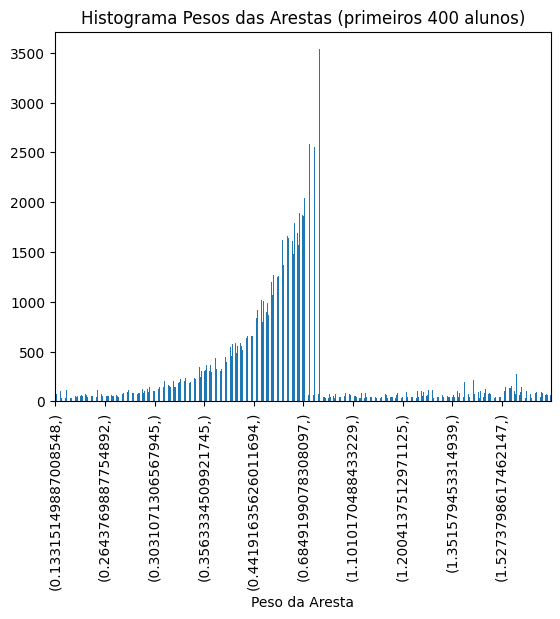

In [12]:
pd.DataFrame(weights).value_counts().head(400).sort_index().plot(kind='bar', title="Histograma Pesos das Arestas (primeiros 400 alunos)", xlabel='Peso da Aresta').locator_params(axis='x', nbins=10)
# pd.DataFrame(weights).value_counts().plot(kind='line', ylabel="Histograma Pesos (loglog)",loglog=True, xticks=[])

<Axes: title={'center': 'Histograma Pesos (loglog)'}, xlabel='Pesos ordenados por ocorrência'>

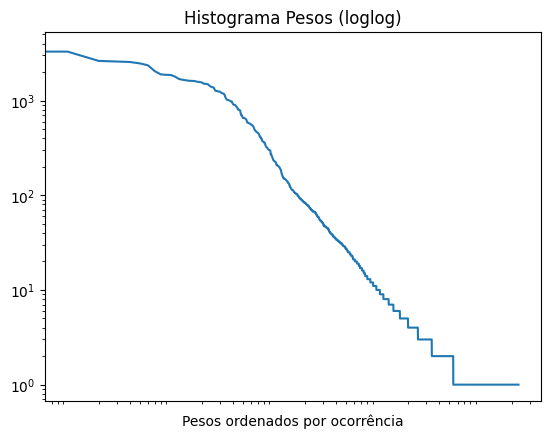

In [13]:
pd.DataFrame(weights).value_counts().plot(kind='line', title="Histograma Pesos (loglog)",loglog=True, xlabel='Pesos ordenados por ocorrência', xticks=[])

<Axes: title={'center': 'Histograma dos Pesos (loglog)'}, xlabel='Peso', ylabel='Ocorrência'>

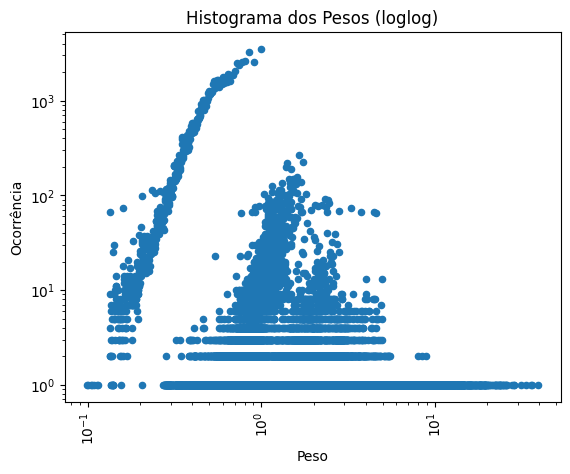

In [17]:
df3 = pd.DataFrame(pd.DataFrame(weights).value_counts()).reset_index()
df3.plot(kind='scatter',x=0,y="count",
         title="Histograma dos Pesos (loglog)",
         ylabel="Ocorrência", xlabel="Peso", loglog=True, rot=90)

In [18]:
def createGraph(n_vertices, edges, weights):
    g = ig.Graph(n_vertices, edges)
    g["title"] = "Similaridade entre Alunos"
    g.es["weights"] = weights
    return g

g = createGraph(numStudents, edges, weights)

In [19]:
weightedDegrees = []
for a in g.vs:
    sum = 0
    for ea in a.incident():
        sum += ea.attributes()["weights"]
    weightedDegrees.append(sum)
pd.DataFrame(weightedDegrees).describe()
# pd.DataFrame(weightedDegrees).value_counts().tail(-2).head(70).plot(kind='bar', ylabel="Histograma Graus com Pesos", xticks=[])
# Removendo os dois alunos com grau outlier (múltiplas respostas)
# pd.DataFrame(weightedDegrees).value_counts().head(70).plot(kind='bar', ylabel="Histograma Graus com Pesos", xticks=[])


,0
count,882.000000
mean,351.726704
std,337.430634
min,23.441639
25%,151.946995
50%,267.261679
75%,441.747321
max,2970.576825


In [20]:
w_df2 = pd.DataFrame(weightedDegrees)
w_df2[w_df2[0] > 2970]
grouped[grouped.index == 412]["tempo_resposta"]

412    [1.0, 0.0, 0.0, 1.0, 4.0, 2.0, 5.0, 1.0, 0.0, ...
Name: tempo_resposta, dtype: object

In [21]:
grouped.iloc[195]

id_aluno                        3a280b06-eff7-4016-988f-4fbb6e54d22e
id_questao         [d2a42c93-f276-489c-a603-97e3e2a780b6, b80be7c...
acerto_resposta                                      [1.0, 1.0, 1.0]
tempo_resposta                                    [74.0, 45.0, 23.0]
Name: 195, dtype: object

<Axes: >

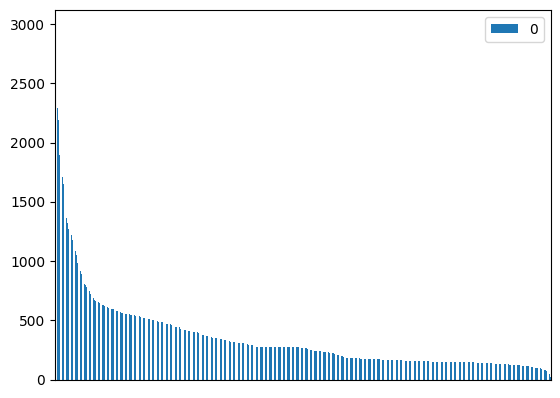

In [22]:
w_df2.sort_values(by=0, ascending=False).plot(kind="bar", xticks=[])

In [23]:

w_df2.sort_values(by=0, ascending=False)

,0
412,2970.576825
600,2552.127050
251,2457.479804
90,2326.613678
299,2287.617582
...,...
10,68.118767
462,61.695940
597,44.848642
6,44.508580


In [24]:
w_df2.sort_values(by=0, ascending=False).head(10)

,0
412,2970.576825
600,2552.127050
251,2457.479804
90,2326.613678
299,2287.617582
700,2228.958459
240,2192.586263
524,1923.303957
633,1894.459358
848,1840.587559


In [25]:
def plotGraph(g, name):
    # Note that attributes can be set globally (e.g. vertex_size), or set individually using arrays (e.g. vertex_color)
    fig, ax = plt.subplots(figsize=(5,5))
    ig.plot(
        g,
        target=ax,
        vertex_size=0.1,
        vertex_color=["steelblue"],
        vertex_frame_width=4.0,
        vertex_frame_color="white",
        vertex_label=g.vs.indices,
        vertex_label_size=7.0
        # edge_color=g.es["weights"]
        # edge_color=["#7142cf" if win == "1" else "salmon" for win in g.es["weights"]]
    )
    plt.show()
    fig.savefig(name + '.png')
    fig.savefig(name + '.jpg')
    fig.savefig(name + '.pdf')
    g.save(name + ".gml")
    g = ig.load(name + ".gml")
# plotGraph(g, "Alunos_2")

clusterizar
- modularidade
- NMI

<Axes: xlabel='tempo_resposta', ylabel='Frequência de ocorrência'>

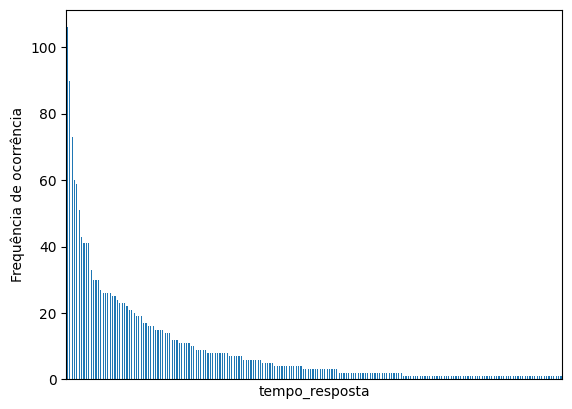

In [26]:
# df["tempo_resposta"].value_counts().head(50).plot(kind='bar', ylabel="Frequência de ocorrência")
# .tail(-1) pois df["tempo_resposta"] == 0.0 é muito frequente
df["tempo_resposta"].value_counts().tail(-1).head(300).plot(kind='bar', ylabel="Frequência de ocorrência", xticks=[])
# df["tempo_resposta"].value_counts().tail(-1).plot(kind='bar', ylabel="Frequência de ocorrência")

In [27]:
clusteredIM = g.community_infomap(edge_weights='weights', trials=15)
print("Modularidade: " + str(clusteredIM.modularity))
clusteredIM.summary()

Modularidade: 0.0


'Clustering with 882 elements and 1 clusters'

In [28]:
clusteredFG = g.community_fastgreedy(weights='weights').as_clustering()
print("Modularidade: " + str(clusteredFG.modularity))
clusteredFG.summary()

Modularidade: 0.24258373265749233


'Clustering with 882 elements and 4 clusters'

In [29]:
clusteredLP = g.community_label_propagation(weights='weights',initial=[+(i < 100) for i in range(0,numStudents)])
print("Modularidade: " + str(clusteredLP.modularity))
clusteredLP.summary()

Modularidade: 0.0


'Clustering with 882 elements and 1 clusters'

In [30]:
clusteredLE = g.community_leading_eigenvector(weights='weights')
print("Modularidade: " + str(clusteredLE.modularity))
clusteredLE.summary()

Modularidade: 0.2604914269488371


'Clustering with 882 elements and 4 clusters'

/tmp/ipykernel_7233/28832953.py:1: DeprecationWarning: resolution_parameter keyword argument is deprecated, use resolution=... instead
  a = [ g.community_leiden(weights='weights',resolution_parameter=i*0.05, beta=1, n_iterations=10).modularity for i in range(0,20)]


<Axes: xlabel='Resolution Parameter', ylabel='Modularidade'>

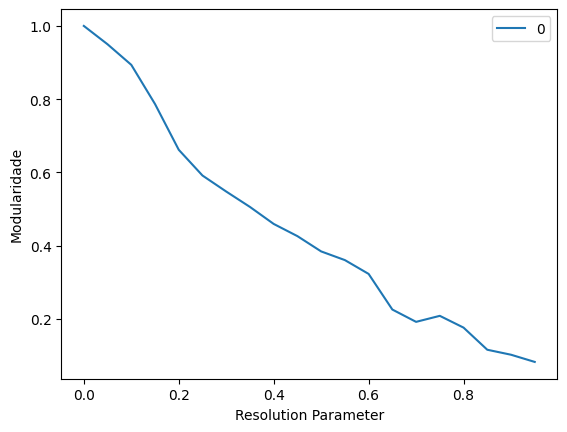

In [31]:
a = [ g.community_leiden(weights='weights',resolution_parameter=i*0.05, beta=1, n_iterations=10).modularity for i in range(0,20)]
dfL = pd.DataFrame(a, [i*0.05 for i in range(0,20)])
dfL.plot(kind='line', xlabel='Resolution Parameter', ylabel="Modularidade")
# a["y"] = [i for i in range(0,20)]
# a

In [32]:
clusteredL = g.community_leiden(weights='weights',resolution_parameter=0.17, beta=1, n_iterations=10)
print("Modularidade: " + str(clusteredL.modularity))
clusteredL.summary()       

Modularidade: 0.7491656086124937


/tmp/ipykernel_7233/1996311836.py:1: DeprecationWarning: resolution_parameter keyword argument is deprecated, use resolution=... instead
  clusteredL = g.community_leiden(weights='weights',resolution_parameter=0.17, beta=1, n_iterations=10)


'Clustering with 882 elements and 8 clusters'

In [39]:
clusteredML = g.community_multilevel(weights='weights')
print("Modularidade: " + str(clusteredML.modularity))
clusteredML.summary()

Modularidade: 0.26572928910751914


'Clustering with 882 elements and 5 clusters'

In [34]:
# DANGER | DANGER | DANGER | Chrashando o notebook
# clusteredOM = g.community_optimal_modularity(weights='weights')
# print("Modularidade: " + str(clusteredOM.modularity))
# clusteredOM.summary()       

In [35]:
# 2m 50s + runtime
# clusteredSG = g.community_spinglass(weights='weights')
# print("Modularidade: " + str(clusteredSG.modularity))
# clusteredSG.summary()

In [36]:
clusteredWT = g.community_walktrap(weights='weights').as_clustering()
print("Modularidade: " + str(clusteredWT.modularity))
clusteredWT.summary()

Modularidade: 0.1768441121093176


'Clustering with 882 elements and 5 clusters'

In [37]:
def plotGraphWithClusterColors(g, clustering, name):
    # Note that attributes can be set globally (e.g. vertex_size), or set individually using arrays (e.g. vertex_color)
    fig, ax = plt.subplots(figsize=(5,5))
    clusterToColor = { 0: "steelblue", 1: "salmon", 2: "yellow", 3: "#333333",
                       4: "#000000", 5: "#606060", 6: "#909090", 7: "#C0C0C0",}
    ig.plot(
        g,
        target=ax,
        vertex_size=0.1,
        vertex_color=[clusterToColor[a] for a in clustering.membership],
        # vertex_frame_width=4.0,
        # vertex_frame_color="white",
        vertex_label=g.vs.indices,
        vertex_label_size=4.0
        # edge_color=g.es["weights"]
        # edge_color=["#7142cf" if win == "1" else "salmon" for win in g.es["weights"]]
    )
    plt.show()
    fig.savefig(name + '.png')
    fig.savefig(name + '.jpg')
    fig.savefig(name + '.pdf')
    g.save(name + ".gml")
    g = ig.load(name + ".gml")
# plotGraph(g, "Alunos_2")

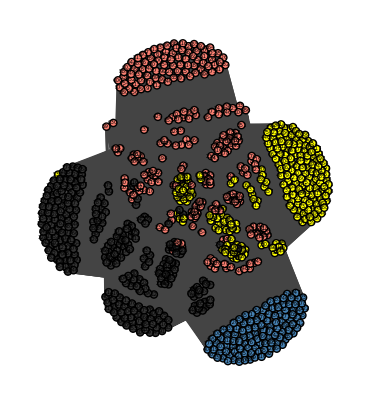

In [41]:
plotGraphWithClusterColors(g, clusteredFG, "Clusteres Fast and Greedy")
# |C| = 4

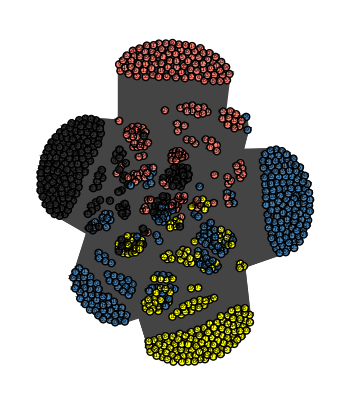

In [38]:
plotGraphWithClusterColors(g, clusteredLE, "Clusteres Leading Eigenvector")
# |C| = 4

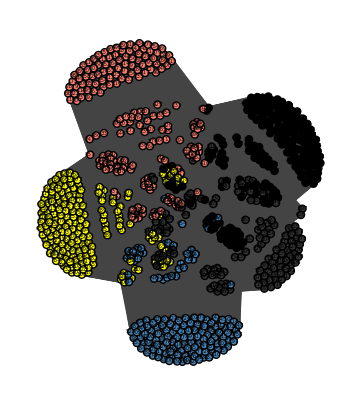

In [40]:
plotGraphWithClusterColors(g, clusteredML, "Clustered Multilevel")
# |C| = 5

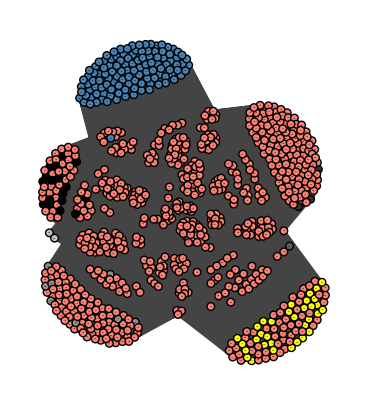

In [ ]:
plotGraphWithClusterColors(g, clusteredL, "Clustered Leiden R=0.17")
# |C| = 8

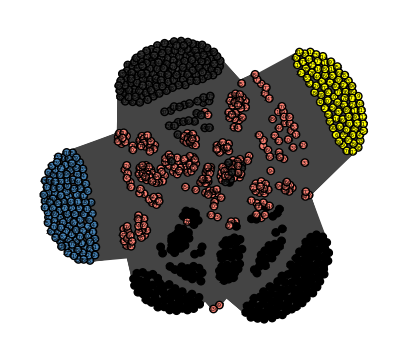

In [42]:
plotGraphWithClusterColors(g, clusteredWT, "Clustered WalkTrap")
# |C| = 5

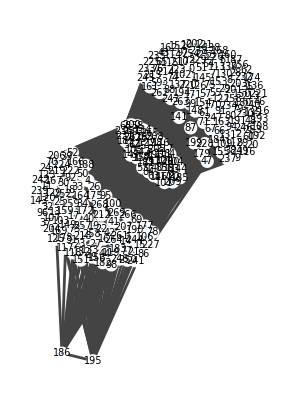

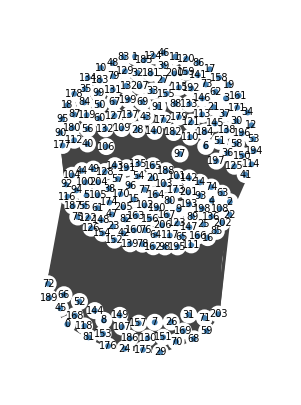

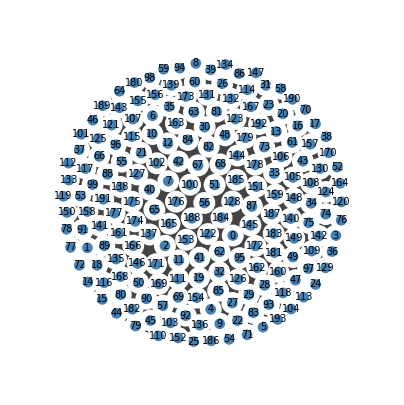

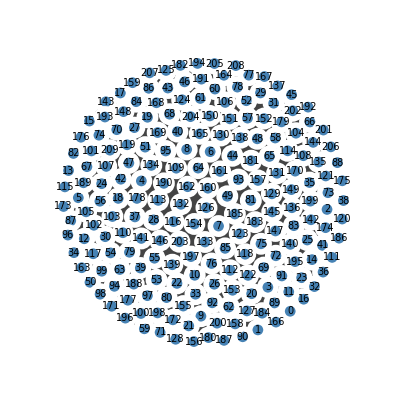

In [ ]:
for subgraph in clusteredLE.subgraphs():
    plotGraph(subgraph,"yo")

In [ ]:
ig.plot(g,mark_groups={})

In [ ]:
for subgraph in clusteredLE.subgraphs():
    subgraph.plot()

IGRAPH U--- 270 24573 --
+ attr: title (g), weights (e)
+ edges:
  0 --   1   2   3   5   6   7   8   9  10  12  20  28  29  35  36  38  43  45
46  47  48  51  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68
71  72  74  75  76  79  80  81  82  83  84  85  87  88  89  90  91  93  94  97
99 101 102 104 105 108 109 110 111 112 113 114 115 116 121 122 124 126 127 128
130 131 134 135 136 137 138 139 140 141 142 144 145 146 147 148 150 152 153
154 155 157 158 160 161 162 163 165 168 170 171 173 174 176 179 180 181 184
185 187 189 191 192 193 194 196 197 198 199 200 201 202 203 205 208 209 210
211 213 214 215 216 217 220 221 223 225 226 228 229 230 231 232 233 234 235
236 237 238 240 243 245 246 247 249 251 253 254 255 256 260 262 263 265 267
  1 --   0   2   3   5   6   7   8   9  10  12  20  28  29  35  36  38  43  45
46  47  48  51  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68
71  72  74  75  76  79  80  81  82  83  84  85  87  88  89  90  91  93  94  97
99

In [ ]:
plotGraph(clusteredLE.cluster_graph(),name="Clusteres Leading Eigenvector")

In [ ]:
for i in clusteredLE.cluster_graph().es():
    print(i)

In [49]:
i=0
for subg in clusteredL.subgraphs():
    i+=1
    print("Subgrafo "+str(i)+": N = " + str(len(subg.vs)))

Subgrafo 1: N = 116
Subgrafo 2: N = 702
Subgrafo 3: N = 33
Subgrafo 4: N = 3
Subgrafo 5: N = 17
Subgrafo 6: N = 1
Subgrafo 7: N = 8
Subgrafo 8: N = 2
